# Импортируем библиотеки

In [20]:
# Импортируем библиотеки

import re
import numpy as np
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import SimpleImputer, KNNImputer, IterativeImputer

# Загружаем датасеты

In [21]:
# Загружаем датасеты

df_train = pd.read_csv('data/train.csv', low_memory=False) # Train датасет
df_valid = pd.read_csv('data/valid.csv', low_memory=False) # Valid датасет

# Информация о Train датасете

In [22]:
# Характеристика датасета

df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14456 entries, 0 to 14455
Columns: 2666 entries, report_date to col2663
dtypes: float64(2316), int64(3), object(347)
memory usage: 294.0+ MB


In [23]:
# В виде таблицы

df_train.head()

,report_date,client_id,target,col1,col2,col3,col4,col5,col6,col7,...,col2654,col2655,col2656,col2657,col2658,col2659,col2660,col2661,col2662,col2663
0,2022-11-01,1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.256261
1,2022-11-01,5,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,7616803.0,7616803.0,7616803.0,NaN,NaN,NaN,7616803.0,7616803.0,7616803.0,0.256261
2,2022-05-01,6,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.256261
3,2022-09-01,7,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.258682
4,2022-08-01,8,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.254164


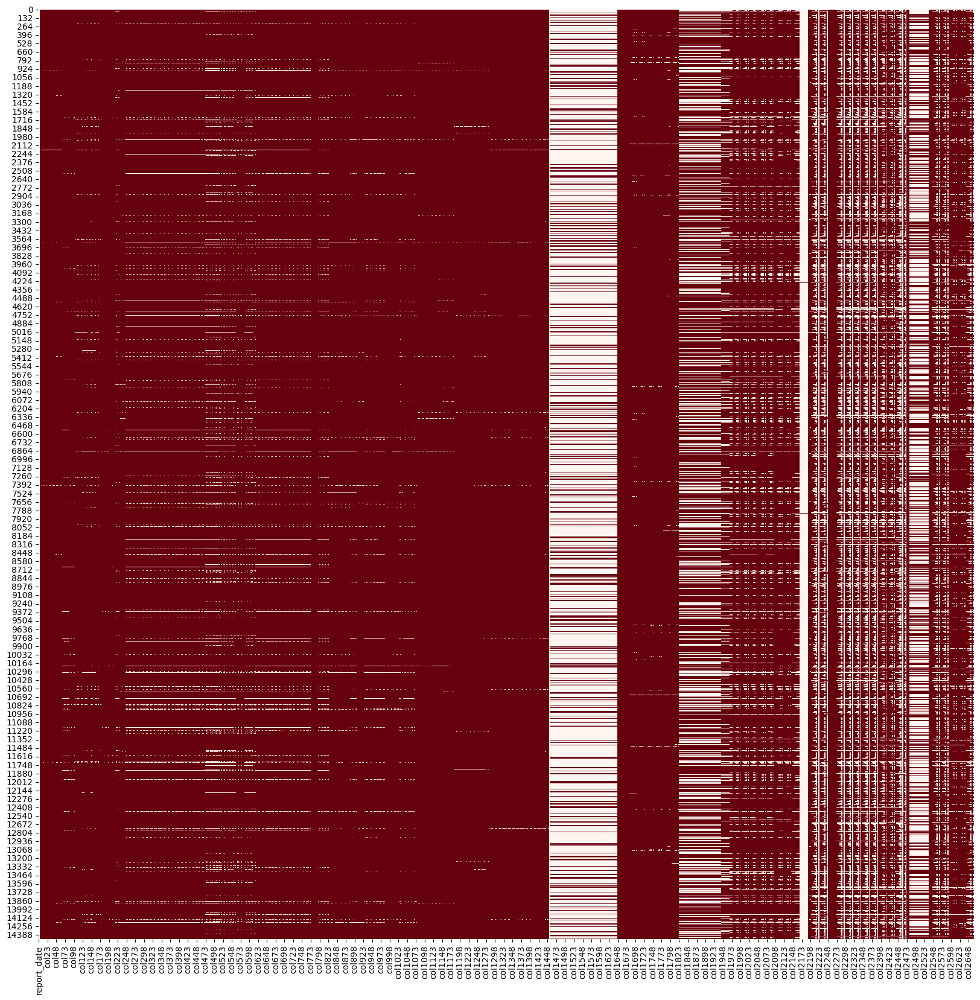

In [24]:
# Хитмапа датасета

plt.figure(figsize=(20, 20))
sb.heatmap(df_train.isnull(), cbar=False, cmap='Reds')
plt.show()

# Обрабатываем датасет

In [29]:
# Отбрасываем колонки в которых нет 50 % информации
df_train_processed = df_train.loc[:, df_train.notnull().mean() >= 0.5]

# Отбрасываем лишние колонки
df_train_processed = df_train_processed.drop(columns=['report_date', 'col1454'])

# Заполняем пропуски с помощью соседей
# imputer = KNNImputer(n_neighbors=5)
# df_train_processed = imputer.fit_transform(df_train_processed)
# df_train_processed = pd.DataFrame(df_train_processed)

# Заполняем пропуски
df_train_processed = pd.DataFrame(
          SimpleImputer(missing_values=np.nan, strategy='most_frequent').fit_transform(df_train_processed), # Думаю что most_frequent подойдет лучше, например в колонках где только целые числа - будут целые числа, где float - там будут float
          columns=df_train_processed.columns)

# Заполнение пропусков с помощью IterativeImputer НЕ РАБОТАЕТ
# from sklearn.tree import DecisionTreeRegressor
# X = df_train_processed.copy(deep = True) #создаем копию датасета
# myImputer=IterativeImputer(estimator=DecisionTreeRegressor(), max_iter=10, random_state=0)
# myImputer.fit(X)
# myImputer_data = myImputer.transform(X)
# df_train_processed = pd.DataFrame(myImputer_data,columns = df_train_processed.columns)

# Сортируем по client_id
# df_train_processed = df_train_processed.sort_values('client_id')

# Баланс классов

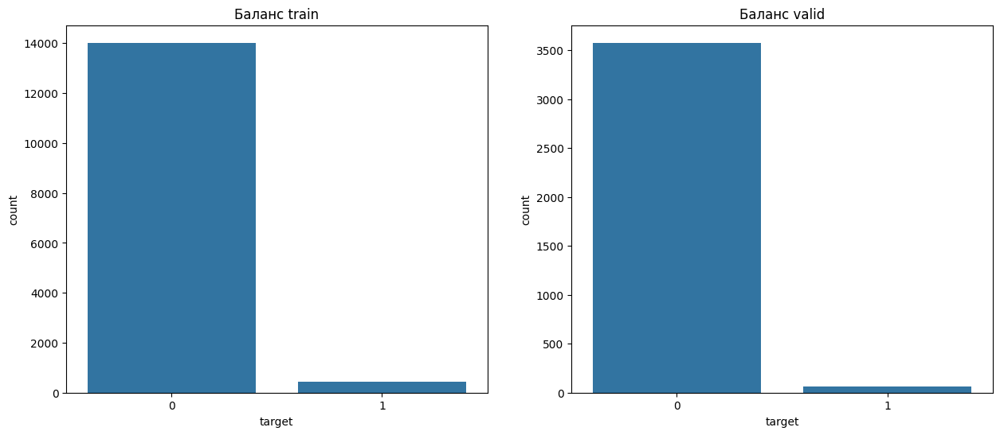

In [30]:
# Смотрим баланс классов


target_distribution_train = df_train['target'].value_counts()
target_distribution_val = df_valid['target'].value_counts()
fig, axs = plt.subplots(1, 2, figsize=(15, 6))

# train датасет
sb.countplot(x='target', data=df_train, ax=axs[0])  #
axs[0].set_title('Баланс train')

# valid датасет
sb.countplot(x='target', data=df_valid, ax=axs[1])  
axs[1].set_title('Баланс valid')

plt.show()

# Конечный результат

In [31]:
# Характеристика датасета

df_train_processed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14456 entries, 0 to 14455
Columns: 341 entries, 0 to 340
dtypes: float64(341)
memory usage: 37.6 MB


In [32]:
# В виде таблицы

df_train_processed.head()

,0,1,2,3,4,5,6,7,8,9,...,331,332,333,334,335,336,337,338,339,340
0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,7069600.000,5759900.000,6414750.000,120.0,96.0,108.0,7693600.0,5990990.0,6842295.0,0.256261
1,5.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,5903704.000,5903704.000,5903704.000,362.0,362.0,362.0,7616803.0,7616803.0,7616803.0,0.256261
2,6.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,...,3480800.000,2171100.000,2825950.000,216.0,192.0,204.0,4525040.0,2822430.0,3673735.0,0.256261
3,7.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,8191045.168,6881345.168,7536195.168,327.2,303.2,315.2,8994546.2,7291936.2,8143241.2,0.258682
4,8.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,...,6544400.000,5234700.000,5889550.000,295.6,271.6,283.6,7246490.0,5543880.0,6395185.0,0.254164


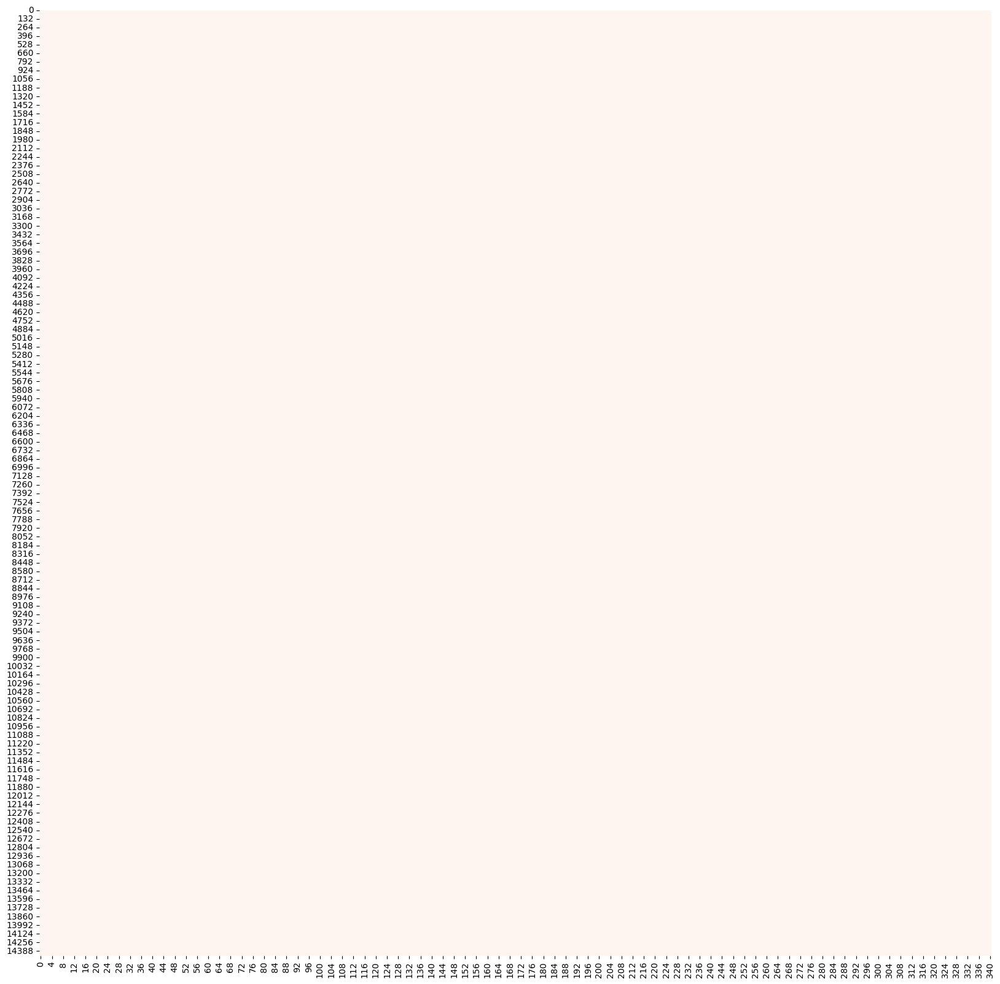

In [33]:
# Хитмапа датасета

plt.figure(figsize=(20, 20))
sb.heatmap(df_train_processed.isnull(), cbar=False, cmap='Reds')
plt.show()

In [34]:
print(df_train_processed.to_string())

          0    1    2    3     4     5     6     7     8     9     10   11    12    13    14    15    16    17    18   19   20   21   22   23   24   25   26   27   28   29   30   31   32   33   34   35   36   37   38   39   40   41   42   43   44   45   46   47   48   49   50   51   52   53   54   55   56   57   58   59   60   61   62   63   64   65   66   67   68   69   70   71   72   73   74   75   76   77   78   79   80   81   82   83   84   85   86   87   88   89   90   91   92   93   94   95   96   97   98   99   100  101  102  103  104  105  106  107  108  109  110  111  112  113  114  115  116  117  118  119  120  121  122  123  124  125  126  127  128  129  130  131  132  133  134  135  136  137  138  139  140  141  142  143  144  145  146  147  148  149  150  151  152  153  154  155  156  157  158  159  160  161  162  163  164  165  166  167  168  169  170  171  172  173  174  175  176  177  178  179  180  181  182  183  184  185  186  187  188  189  190  191  192  193  194  1

# Приводим valid датасет к train датасету

In [35]:
# Приводим valid датасет к train

train_columns = df_train_processed.columns 
df_valid_processed = df_valid[train_columns]

print(f'{df_train_processed.shape}\n{df_valid_processed.shape}')

KeyError: 'None of [RangeIndex(start=0, stop=341, step=1)] are in the [columns]'

# Сохраняем датасеты

In [61]:
df_train_processed.to_csv('data/train_processed.csv')
df_valid_processed.to_csv('data/valid_processed.csv')